<a href="https://colab.research.google.com/github/aganjasarthak/Deploy_icp/blob/main/linear_regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd

!git clone https://github.com/aganjasarthak/Deploy_icp.git
df = pd.read_csv('/content/Deploy_icp/insurance.csv')
print(df.head())

fatal: destination path 'Deploy_icp' already exists and is not an empty directory.
   age     sex     bmi  children smoker     region      charges
0   19  female  27.900         0    yes  southwest  16884.92400
1   18    male  33.770         1     no  southeast   1725.55230
2   28    male  33.000         3     no  southeast   4449.46200
3   33    male  22.705         0     no  northwest  21984.47061
4   32    male  28.880         0     no  northwest   3866.85520


   age     sex     bmi  children smoker     region      charges
0   19  female  27.900         0    yes  southwest  16884.92400
1   18    male  33.770         1     no  southeast   1725.55230
2   28    male  33.000         3     no  southeast   4449.46200
3   33    male  22.705         0     no  northwest  21984.47061
4   32    male  28.880         0     no  northwest   3866.85520
age           int64
sex          object
bmi         float64
children      int64
smoker       object
region       object
charges     float64
dtype: object
age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64


/tmp/ipython-input-2-2102979227.py:19: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(df['charges'], kde=True, color='c')


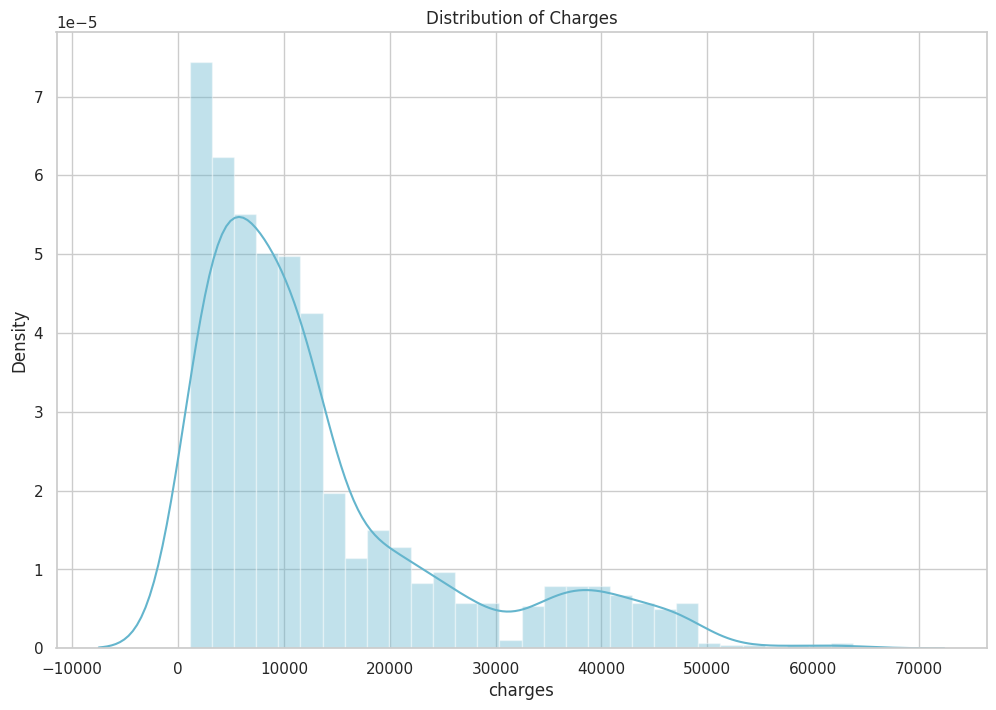

/tmp/ipython-input-2-2102979227.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(np.log10(df['charges']), kde=True, color='r')


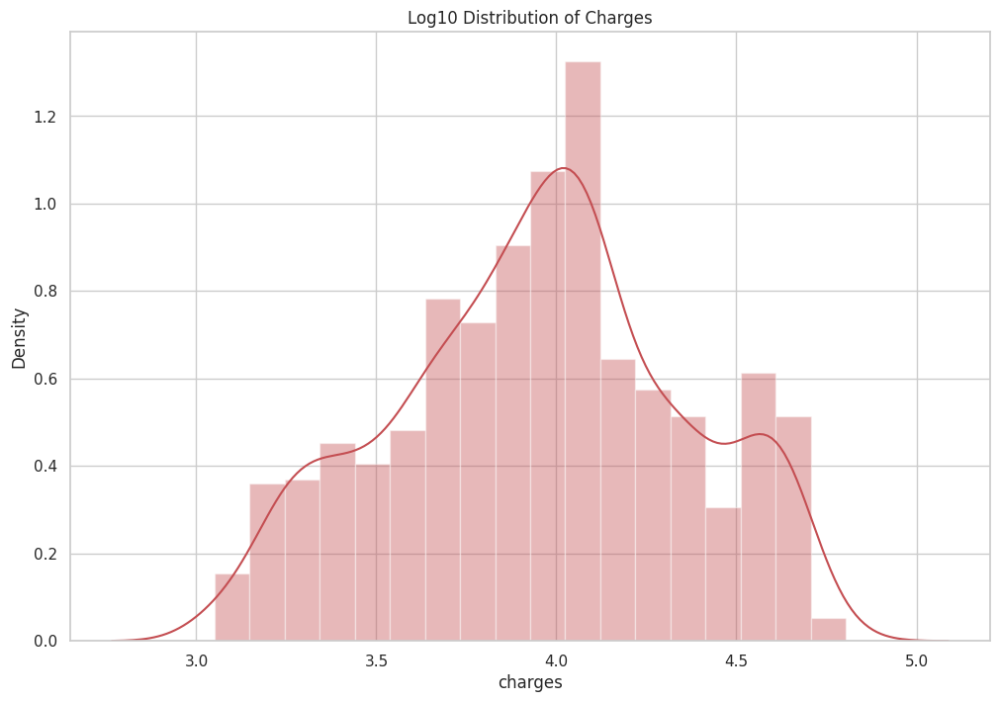

/tmp/ipython-input-2-2102979227.py:32: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(


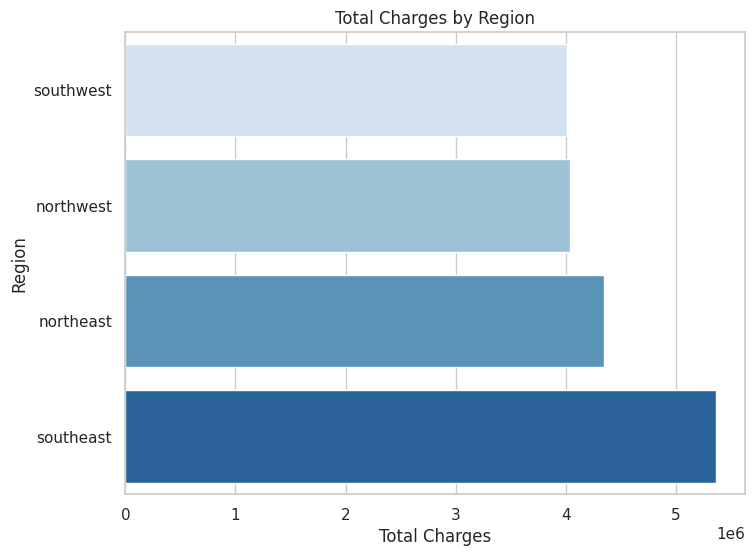

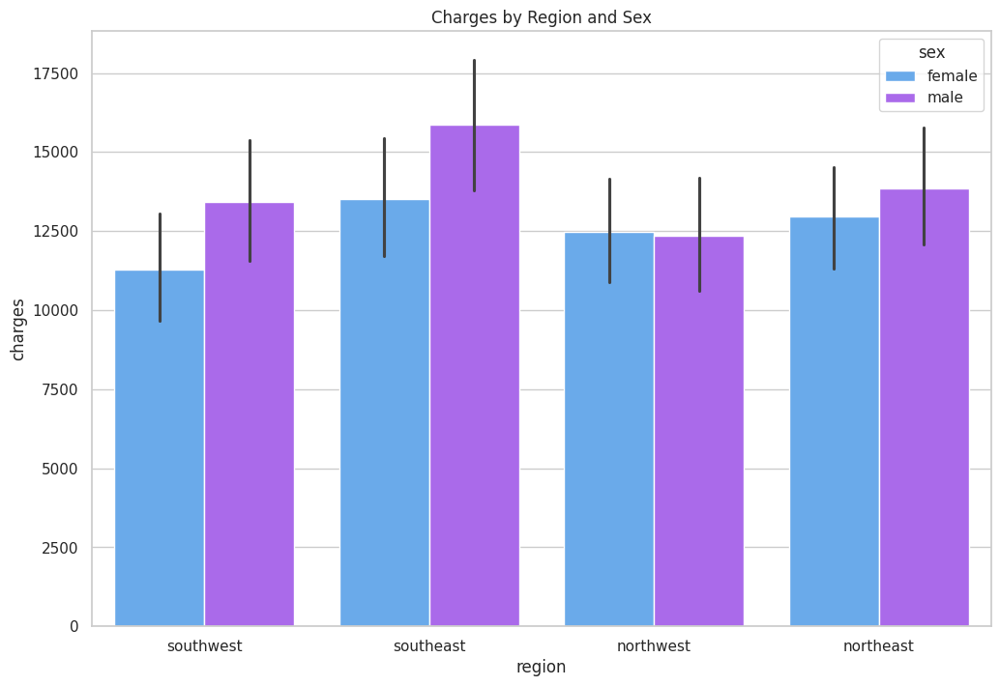

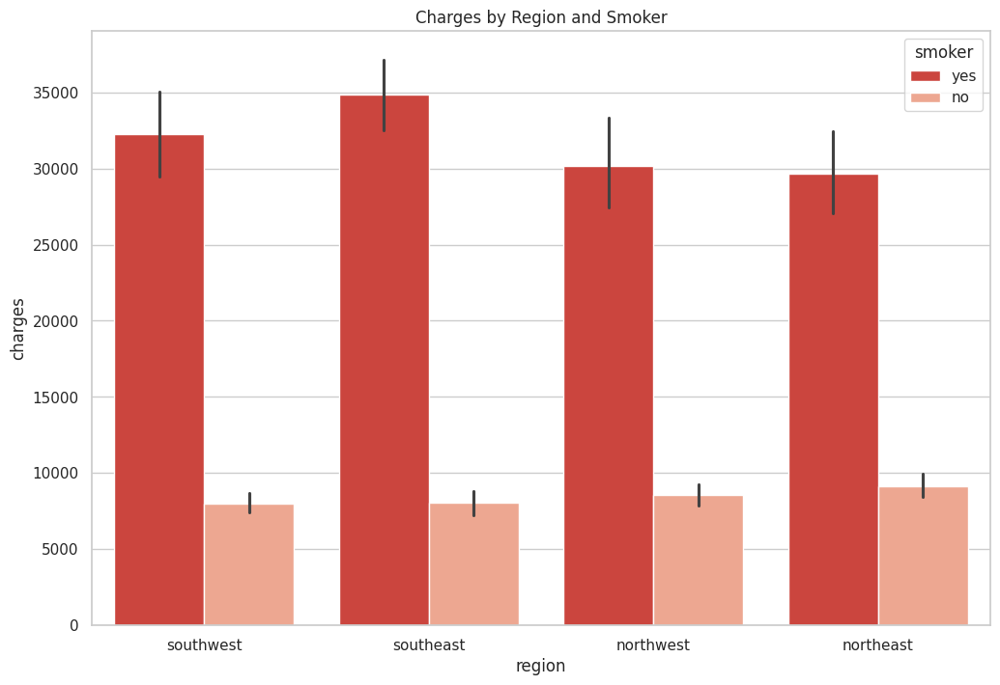

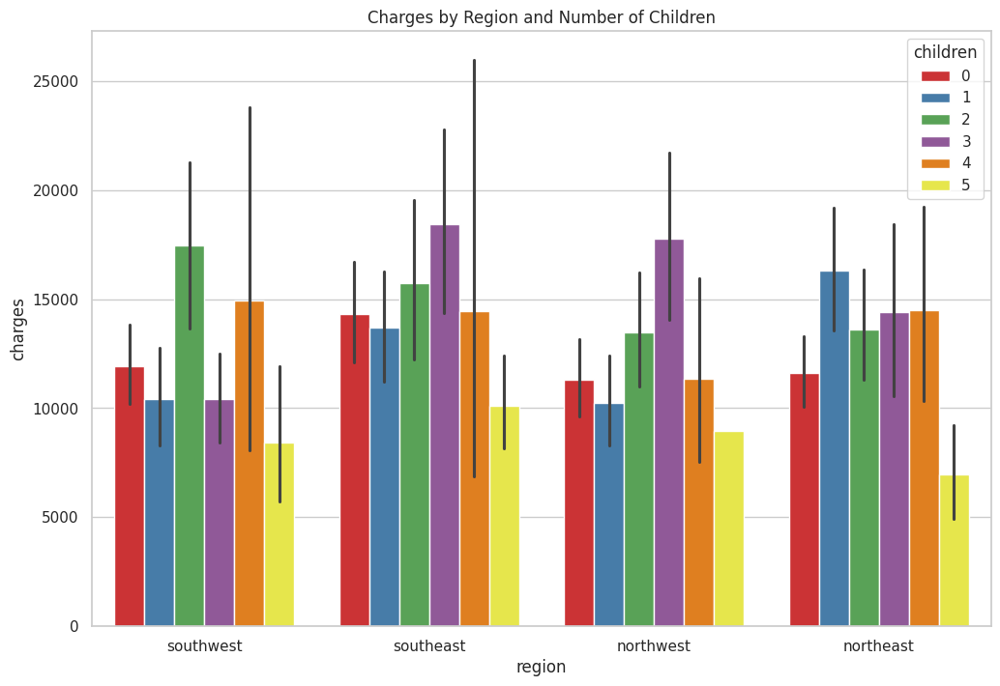

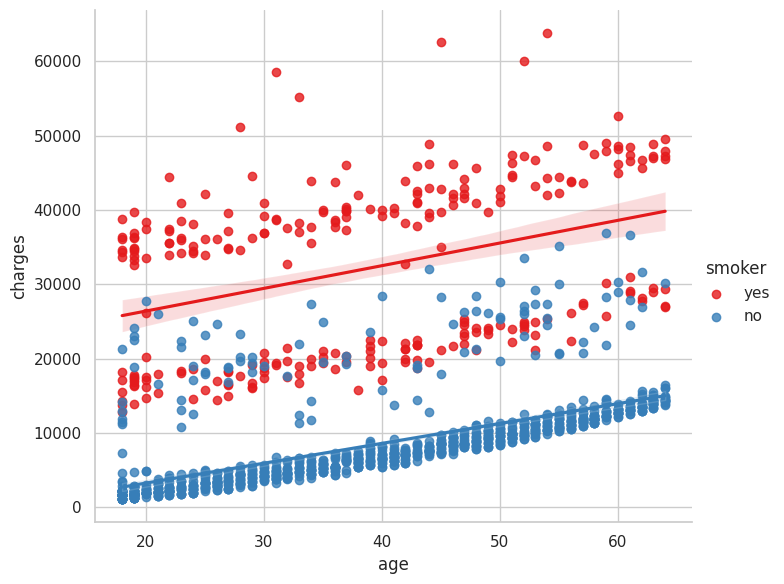

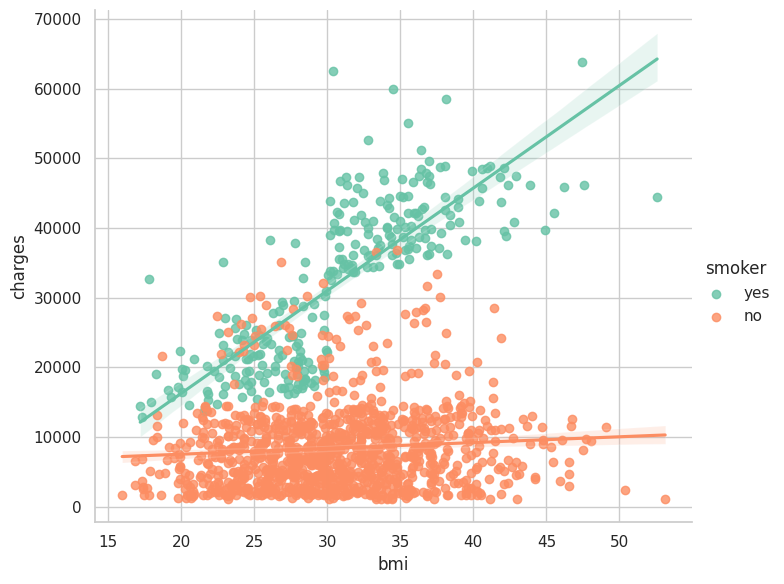

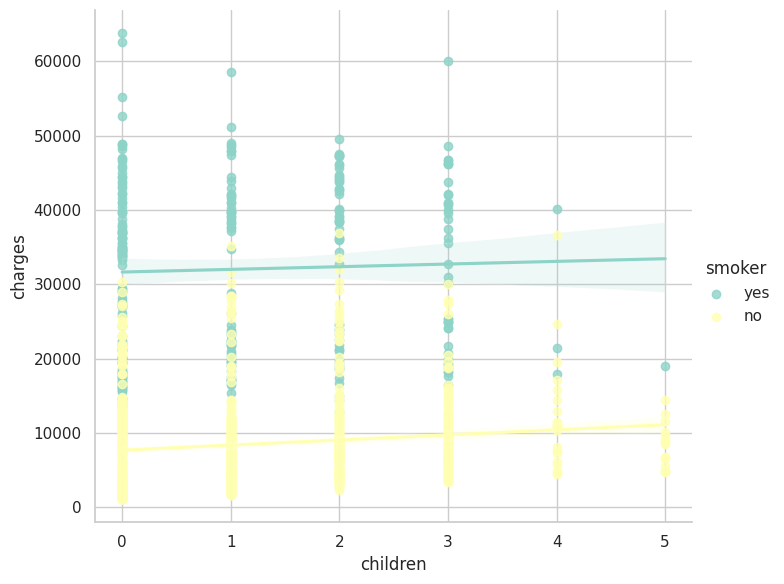

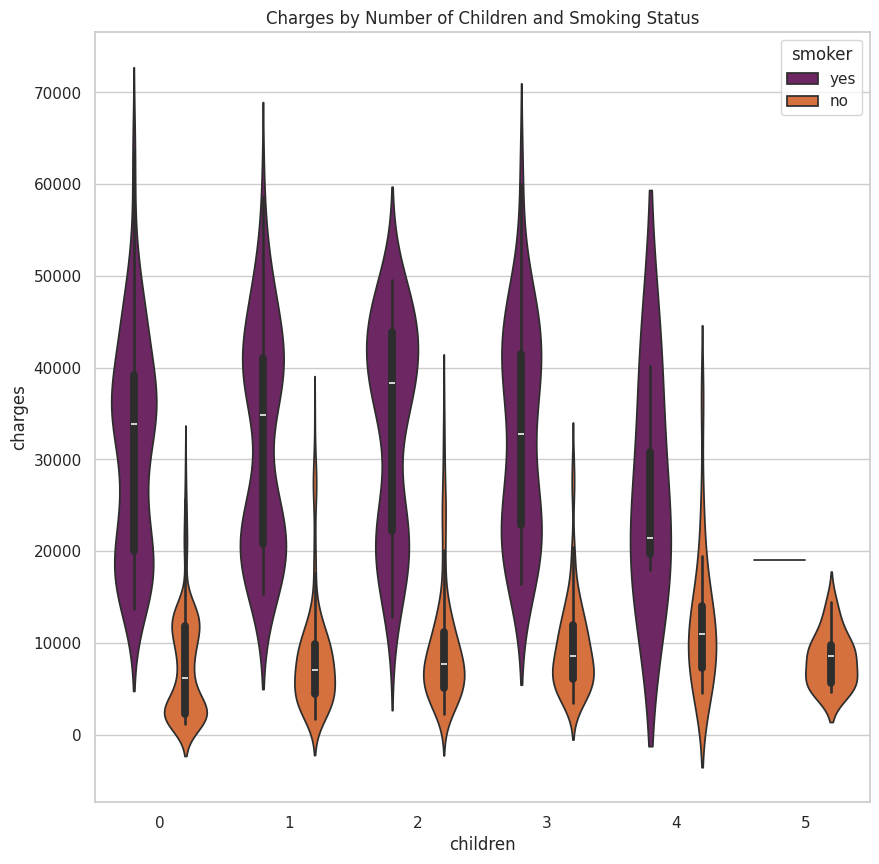

age            int64
sex         category
bmi          float64
children       int64
smoker      category
region      category
charges      float64
dtype: object
age           int64
sex           int64
bmi         float64
children      int64
smoker        int64
region        int64
charges     float64
dtype: object


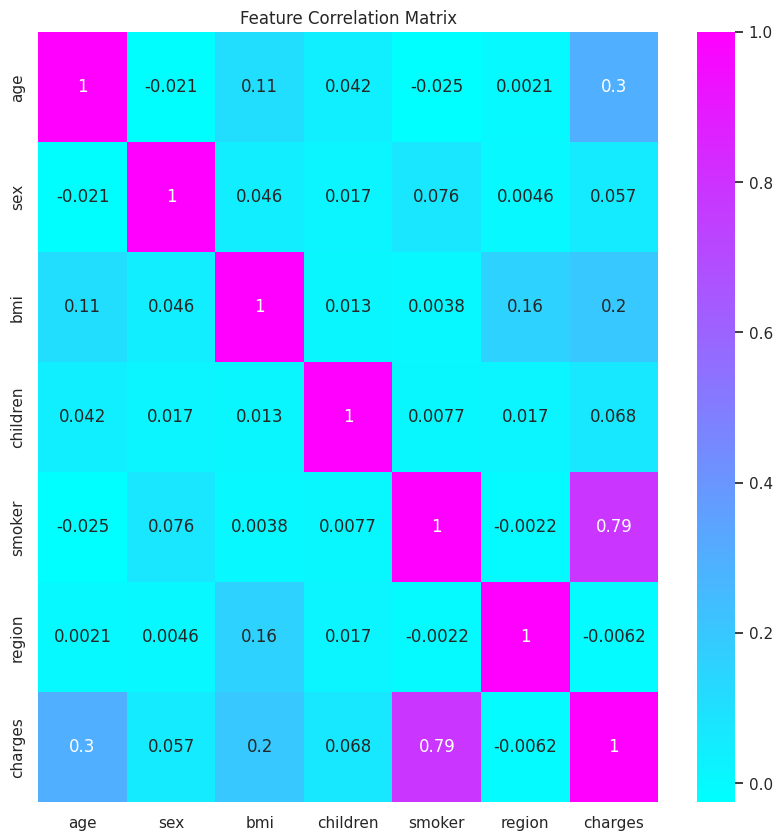

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split as holdout
from sklearn.linear_model import LinearRegression
from sklearn import metrics


# Initial glimpse
print(df.head())
print(df.dtypes)
print(df.isnull().sum())

# Distribution of charges
sns.set(style='whitegrid')
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(df['charges'], kde=True, color='c')
plt.title('Distribution of Charges')
plt.show()

# Log-transformed distribution
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(np.log10(df['charges']), kde=True, color='r')
plt.title('Log10 Distribution of Charges')
plt.show()

# Charges by region (fixed)
charges = df['charges'].groupby(df.region).sum().sort_values(ascending=True)
f, ax = plt.subplots(1, 1, figsize=(8, 6))
ax = sns.barplot(
    x=charges.values,
    y=charges.index,
    palette='Blues'
)
plt.title('Total Charges by Region')
plt.xlabel('Total Charges')
plt.ylabel('Region')
plt.show()

# Charges by region and sex
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.barplot(x='region', y='charges', hue='sex', data=df, palette='cool')
plt.title('Charges by Region and Sex')
plt.show()

# Charges by region and smoker
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.barplot(x='region', y='charges', hue='smoker', data=df, palette='Reds_r')
plt.title('Charges by Region and Smoker')
plt.show()

# Charges by region and children
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.barplot(x='region', y='charges', hue='children', data=df, palette='Set1')
plt.title('Charges by Region and Number of Children')
plt.show()

# Scatter plots with regression lines
sns.lmplot(x='age', y='charges', data=df, hue='smoker', palette='Set1', height=6, aspect=1.2)
sns.lmplot(x='bmi', y='charges', data=df, hue='smoker', palette='Set2', height=6, aspect=1.2)
sns.lmplot(x='children', y='charges', data=df, hue='smoker', palette='Set3', height=6, aspect=1.2)
plt.show()

# Violin plot of charges by children and smoker
f, ax = plt.subplots(1, 1, figsize=(10, 10))
ax = sns.violinplot(x='children', y='charges', data=df, orient='v', hue='smoker', palette='inferno')
plt.title('Charges by Number of Children and Smoking Status')
plt.show()

# Converting object labels into categorical
df[['sex', 'smoker', 'region']] = df[['sex', 'smoker', 'region']].astype('category')
print(df.dtypes)

# Converting category labels into numerical using LabelEncoder
label = LabelEncoder()
df.sex = label.fit_transform(df.sex)
df.smoker = label.fit_transform(df.smoker)
df.region = label.fit_transform(df.region)
print(df.dtypes)

# Correlation heatmap
f, ax = plt.subplots(1, 1, figsize=(10, 10))
ax = sns.heatmap(df.corr(), annot=True, cmap='cool')
plt.title('Feature Correlation Matrix')
plt.show()

# Linear Regression
x = df.drop(['charges'], axis=1)
y = df['charges']
x_train, x_test, y_train, y_test = holdout(x, y, test_size=0.2, random_state=0)

In [ ]:
import numpy as np

X_train = x_train.values
X_test  = x_test.values
y_train_np = y_train.values.reshape(-1, 1)
y_test_np  = y_test.values.reshape(-1, 1)

mu    = np.mean(X_train, axis=0)
sigma = np.std(X_train, axis=0, ddof=0)
sigma[sigma == 0] = 1.0

X_train_scaled = (X_train - mu) / sigma
X_test_scaled  = (X_test  - mu) / sigma

X_train_b = np.hstack([np.ones((X_train_scaled.shape[0], 1)), X_train_scaled])
X_test_b  = np.hstack([np.ones((X_test_scaled.shape[0], 1)),  X_test_scaled])

n_params = X_train_b.shape[1]
theta = np.zeros((n_params, 1))

lr     = 0.01
epochs = 6000

for epoch in range(epochs):
    y_pred = X_train_b @ theta
    error = y_pred - y_train_np
    grad = (2 / X_train_b.shape[0]) * (X_train_b.T @ error)
    theta -= lr * grad
    if (epoch + 1) % 1000 == 0:
        print(f"Epoch {epoch+1:4d} | MSE: {np.mean(error**2):.4f}")

y_pred_test = X_test_b @ theta

mae  = np.mean(np.abs(y_pred_test - y_test_np))
mse  = np.mean((y_pred_test - y_test_np)**2)
rmse = np.sqrt(mse)
ss_res = np.sum((y_test_np - y_pred_test)**2)
ss_tot = np.sum((y_test_np - np.mean(y_test_np))**2)
r2   = 1 - (ss_res / ss_tot)

print(theta.flatten())
print(mae, mse, rmse, r2)


Epoch 1000 | MSE: 37729580.5098
Epoch 2000 | MSE: 37729580.5098
Epoch 3000 | MSE: 37729580.5098
Epoch 4000 | MSE: 37729580.5098
Epoch 5000 | MSE: 37729580.5098
Epoch 6000 | MSE: 37729580.5098
[ 1.32011821e+04  3.57662148e+03 -1.21609157e+01  2.03070874e+03
  5.36854294e+02  9.50915651e+03 -3.19054720e+02]
3930.333273901142 31845929.134159494 5643.219748880908 0.7998747145449956


     Actual    Predicted
 9724.53000 11017.230479
 8547.69130  9787.530168
45702.02235 37994.782118
12950.07120 16122.778407
 9644.25250  6930.759230
 4500.33925  3969.020462
 2198.18985  1551.784302
11436.73815 14283.209099
 7537.16390  8953.428858
 5425.02335  7431.945577


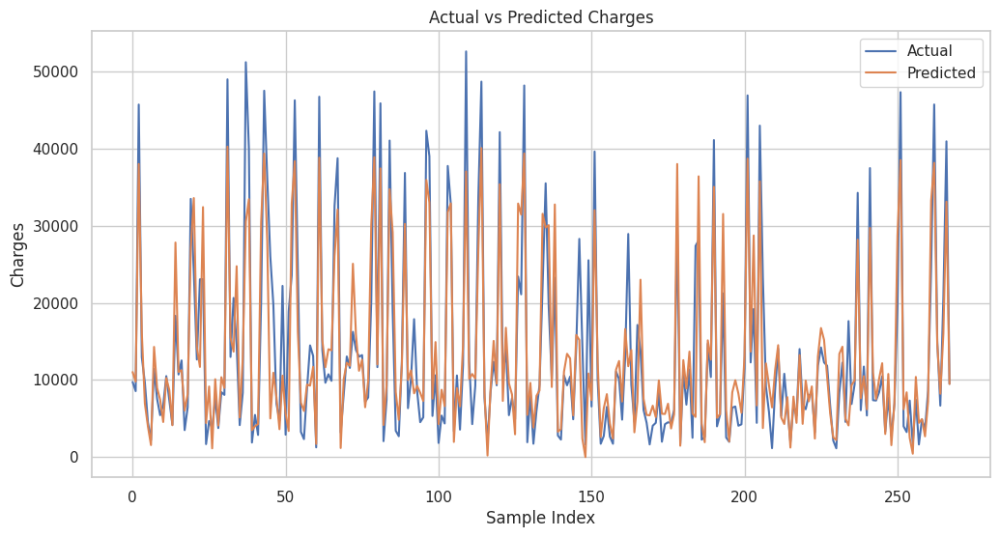

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

y_actual = y_test_np.flatten()
y_pred    = y_pred_test.flatten()

# Numeric comparison
df_compare = pd.DataFrame({
    'Actual':    y_actual,
    'Predicted': y_pred
})
print(df_compare.head(10).to_string(index=False))

# Graphical comparison
plt.figure(figsize=(12, 6))
plt.plot(np.arange(len(y_actual)), y_actual,    label='Actual')
plt.plot(np.arange(len(y_pred)),   y_pred,      label='Predicted')
plt.xlabel('Sample Index')
plt.ylabel('Charges')
plt.title('Actual vs Predicted Charges')
plt.legend()
plt.show()


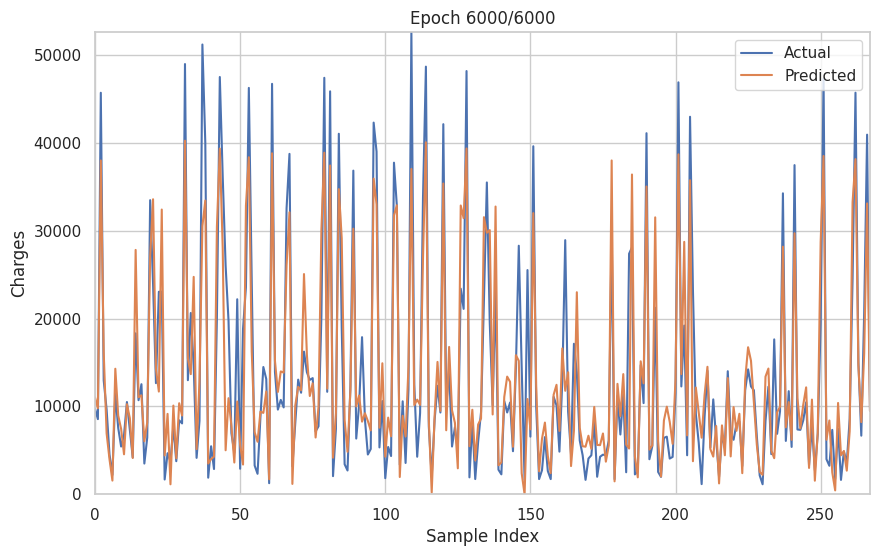

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

X_train = x_train.values
X_test  = x_test.values
y_train_np = y_train.values.reshape(-1, 1)
y_test_np  = y_test.values.reshape(-1, 1)

mu    = np.mean(X_train, axis=0)
sigma = np.std(X_train, axis=0, ddof=0)
sigma[sigma == 0] = 1.0

X_train_scaled = (X_train - mu) / sigma
X_test_scaled  = (X_test  - mu) / sigma

X_train_b = np.hstack([np.ones((X_train_scaled.shape[0], 1)), X_train_scaled])
X_test_b  = np.hstack([np.ones((X_test_scaled.shape[0], 1)),  X_test_scaled])

m      = X_train_b.shape[0]
alpha  = 0.01
iters  = 6000
theta  = np.zeros((X_train_b.shape[1], 1))
pred_history = []

for _ in range(iters):
    error     = X_train_b.dot(theta) - y_train_np
    gradients = (2/m) * X_train_b.T.dot(error)
    theta    -= alpha * gradients
    pred_history.append((X_test_b.dot(theta)).flatten())

y_actual = y_test_np.flatten()
n_samples = len(y_actual)

fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, n_samples - 1)
y_min = min(y_actual.min(), min(min(h) for h in pred_history))
y_max = max(y_actual.max(), max(max(h) for h in pred_history))
ax.set_ylim(y_min, y_max)
line_actual,   = ax.plot(np.arange(n_samples), y_actual,   label='Actual')
line_predicted,= ax.plot([], [], label='Predicted')
ax.set_xlabel('Sample Index')
ax.set_ylabel('Charges')
ax.set_title('Actual vs Predicted Charges Over Epochs')
ax.legend()

def init():
    line_predicted.set_data([], [])
    return line_predicted,

def animate(i):
    line_predicted.set_data(np.arange(n_samples), pred_history[i])
    ax.set_title(f'Epoch {i+1}/{iters}')
    return line_predicted,

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=iters, interval=100, blit=True)

HTML(ani.to_jshtml())
